# Virtual inpainting using GAN

## Imports and Config

In [2]:
import os
import time
import csv
from pathlib import Path

import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
from torchvision import transforms as T
from torchvision.utils import save_image
from tqdm import tqdm

from PIL import Image
import numpy as np

# Optional: Enable GPU if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

Using device: cuda


In [3]:
print(torch.cuda.is_available())
print(torch.cuda.current_device())
print(torch.cuda.get_device_name(torch.cuda.current_device()))

True
0
NVIDIA GeForce RTX 4060 Laptop GPU


In [4]:
x = torch.rand(1).to("cuda" if torch.cuda.is_available() else "cpu")
print("Tensor device:", x.device)

Tensor device: cuda:0


## Config Dictionary

In [5]:
config = {
    "data_root": "data/inpainting-dataset",
    "img_size": (256, 256),
    "batch_size": 4,
    "max_epochs": 10, # originally 10
    "patience": 2, # originally 3
    "g_lr": 1e-4,
    "d_lr": 1e-4,
    "l1_loss_alpha": 1.0,
    "gan_loss_alpha": 0.001,
    "num_workers": 0,
    "pin_memory": False,
    "checkpoint_dir": "checkpoints/",
    "metrics_log": "metrics.csv",
}
os.makedirs(config["checkpoint_dir"], exist_ok=True)


## Dataset Class

In [6]:
class InpaintingDataset(Dataset):
    def __init__(self, img_dir, mask_dir, img_size):
        self.img_dir = Path(img_dir)
        self.mask_dir = Path(mask_dir)
        self.image_files = sorted(list(self.img_dir.glob("*")))
        self.mask_files = sorted(list(self.mask_dir.glob("*")))
        self.transform_img = T.Compose([
            T.Resize(img_size),
            T.ToTensor(),
        ])
        self.transform_mask = T.Compose([
            T.Resize(img_size),
            T.ToTensor(),  # mask will be 0 or 1
        ])

    def __len__(self):
        return len(self.image_files)

    def __getitem__(self, idx):
        img = Image.open(self.image_files[idx]).convert("RGB")
        mask = Image.open(self.mask_files[idx]).convert("L")
        return self.transform_img(img), self.transform_mask(mask)

## DataLoaders

In [7]:
# Paths
train_img_dir = os.path.join(config["data_root"], "train", "img")
train_mask_dir = os.path.join(config["data_root"], "train", "mask")
val_img_dir = os.path.join(config["data_root"], "val", "img")
val_mask_dir = os.path.join(config["data_root"], "val", "mask")
test_img_dir = os.path.join(config["data_root"], "test", "img")
test_mask_dir = os.path.join(config["data_root"], "test", "mask")

# Datasets
train_dataset = InpaintingDataset(train_img_dir, train_mask_dir, config["img_size"])
val_dataset = InpaintingDataset(val_img_dir, val_mask_dir, config["img_size"])
test_dataset = InpaintingDataset(test_img_dir, test_mask_dir, config["img_size"])

# Loaders
train_loader = DataLoader(train_dataset, batch_size=config["batch_size"], shuffle=True,
                          num_workers=config["num_workers"], pin_memory=True)
val_loader = DataLoader(val_dataset, batch_size=config["batch_size"], shuffle=False,
                        num_workers=config["num_workers"], pin_memory=True)
test_loader = DataLoader(test_dataset, batch_size=config["batch_size"], shuffle=False,
                         num_workers=config["num_workers"], pin_memory=True)

## Model Imports

In [8]:
from model.networks import Generator, Discriminator
import model.losses as gan_losses  # Your GAN losses module

## Model Initialization

In [9]:
cnum_in = 3  # RGB input
generator = Generator(cnum_in=cnum_in + 2, cnum_out=cnum_in, cnum=48, return_flow=False).to(device)
discriminator = Discriminator(cnum_in=cnum_in + 1, cnum=64).to(device)

g_optimizer = optim.Adam(generator.parameters(), lr=config["g_lr"], betas=(0.0, 0.9))
d_optimizer = optim.Adam(discriminator.parameters(), lr=config["d_lr"], betas=(0.0, 0.9))

# Loss functions
gan_loss_d = gan_losses.hinge_loss_d
gan_loss_g = gan_losses.hinge_loss_g
l1_loss = nn.L1Loss()

## Training Loop with Early Stopping

In [10]:
def train_loop(generator, discriminator, g_optimizer, d_optimizer, train_loader, val_loader, config):
    best_val_loss = float("inf")
    epochs_no_improve = 0

    scaler = torch.amp.GradScaler('cuda')
    fieldnames = ["epoch", "train_ae_loss", "train_g_loss", "val_ae_loss"]
    log_path = os.path.join(config["checkpoint_dir"], config["metrics_log"])
    with open(log_path, "w", newline="") as f:
        writer = csv.DictWriter(f, fieldnames=fieldnames)
        writer.writeheader()

    for epoch in range(config["max_epochs"]):
        print(f"\n[Epoch {epoch+1}] Starting...")
        start_time = time.time()
        generator.train()
        discriminator.train()

        train_ae_loss_epoch = 0.0
        train_g_loss_epoch = 0.0
        batches = 0

        loop = tqdm(train_loader, desc=f"Epoch {epoch+1}/{config['max_epochs']}")
        for batch_idx, (imgs, masks) in enumerate(loop):
            imgs, masks = imgs.to(device), masks.to(device).float()
            incomplete = imgs * (1 - masks)
            ones_x = torch.ones_like(incomplete[:, 0:1])
            x = torch.cat([incomplete, ones_x, ones_x * masks], dim=1)

            with torch.amp.autocast("cuda"):
                x1, x2 = generator(x, masks)
                completed = x2 * masks + incomplete * (1 - masks)

                real = torch.cat([imgs, masks], dim=1)
                fake = torch.cat([completed.detach(), masks], dim=1)
                d_out = discriminator(torch.cat([real, fake]))
                d_real, d_fake = torch.split(d_out, imgs.size(0))
                d_loss = gan_loss_d(d_real, d_fake)

                ae_loss1 = config["l1_loss_alpha"] * l1_loss(imgs, x1)
                ae_loss2 = config["l1_loss_alpha"] * l1_loss(imgs, x2)
                ae_loss = ae_loss1 + ae_loss2

                fake_for_g = torch.cat([completed, masks], dim=1)
                d_gen = discriminator(fake_for_g)
                g_loss = config["gan_loss_alpha"] * gan_loss_g(d_gen) + ae_loss

            d_optimizer.zero_grad()
            d_loss.backward()
            d_optimizer.step()

            g_optimizer.zero_grad()
            scaler.scale(g_loss).backward()
            scaler.step(g_optimizer)
            scaler.update()

            train_ae_loss_epoch += ae_loss.item()
            train_g_loss_epoch += g_loss.item()
            batches += 1

            loop.set_postfix({
                "ae_loss": f"{ae_loss.item():.4f}",
                "g_loss": f"{g_loss.item():.4f}",
                "d_loss": f"{d_loss.item():.4f}"
            })

        train_ae_loss_epoch /= batches
        train_g_loss_epoch /= batches

        val_ae_loss_epoch = evaluate(generator, val_loader, l1_loss)

        with open(log_path, "a", newline="") as f:
            writer = csv.DictWriter(f, fieldnames=fieldnames)
            writer.writerow({
                "epoch": epoch + 1,
                "train_ae_loss": train_ae_loss_epoch,
                "train_g_loss": train_g_loss_epoch,
                "val_ae_loss": val_ae_loss_epoch
            })

        print(f"[Epoch {epoch+1}] Train AE: {train_ae_loss_epoch:.4f} | Val AE: {val_ae_loss_epoch:.4f}")

        # Save best model
        if val_ae_loss_epoch < best_val_loss:
            print("  ↳ New best model found, saving checkpoint...")
            best_val_loss = val_ae_loss_epoch
            epochs_no_improve = 0
            torch.save(generator.state_dict(), os.path.join(config["checkpoint_dir"], "best_generator.pth"))
            torch.save(discriminator.state_dict(), os.path.join(config["checkpoint_dir"], "best_discriminator.pth"))
        else:
            epochs_no_improve += 1
            print(f"  ↳ No improvement. Patience: {epochs_no_improve}/{config['patience']}")
            if epochs_no_improve >= config["patience"]:
                print("  ↳ Early stopping triggered.")
                break

        # Save every epoch
        torch.save(generator.state_dict(), os.path.join(config["checkpoint_dir"], f"dfv2_generator_epoch_{epoch+1}.pth"))
        torch.save(discriminator.state_dict(), os.path.join(config["checkpoint_dir"], f"dfv2_discriminator_epoch_{epoch+1}.pth"))

        duration = time.time() - start_time
        print(f"[Epoch {epoch+1}] Completed in {duration:.2f} seconds")


## Validation Evaluation Function

In [11]:
@torch.no_grad()
def evaluate(generator, loader, loss_fn):
    generator.eval()
    total_loss = 0.0
    count = 0

    for imgs, masks in loader:
        imgs, masks = imgs.to(device), masks.to(device).float()
        incomplete = imgs * (1 - masks)
        ones_x = torch.ones_like(incomplete[:, 0:1])
        x = torch.cat([incomplete, ones_x, ones_x * masks], dim=1)

        with torch.amp.autocast("cuda"):
            _, x2 = generator(x, masks)
            loss = loss_fn(imgs, x2)

        total_loss += loss.item()
        count += 1

    return total_loss / count

## Test Evaluation Function

In [12]:
@torch.no_grad()
def test_evaluate(generator, loader, loss_fn, save_outputs=False, save_dir=None):
    generator.eval()
    total_loss = 0.0
    count = 0

    if save_outputs and save_dir:
        os.makedirs(save_dir, exist_ok=True)

    for i, (imgs, masks) in enumerate(loader):
        imgs, masks = imgs.to(device), masks.to(device).float()
        incomplete = imgs * (1 - masks)
        ones_x = torch.ones_like(incomplete[:, 0:1])
        x = torch.cat([incomplete, ones_x, ones_x * masks], dim=1)

        with torch.amp.autocast("cuda"):
            _, x2 = generator(x, masks)
            loss = loss_fn(imgs, x2)

        total_loss += loss.item()
        count += 1

        if save_outputs and save_dir:
            output = x2 * masks + incomplete * (1 - masks)
            grid = torch.cat([imgs[0], incomplete[0], output[0]], dim=2)
            save_image(grid, os.path.join(save_dir, f"test_{i:03d}.png"))

    return total_loss / count

## Run Training and Evaluate on Test Set

In [12]:
# Run training
train_loop(generator, discriminator, g_optimizer, d_optimizer, train_loader, val_loader, config)

# Load best model
generator.load_state_dict(torch.load(os.path.join(config["checkpoint_dir"], "best_generator.pth")))

# Evaluate on test set
test_loss = test_evaluate(generator, test_loader, l1_loss,
                          save_outputs=True,
                          save_dir=os.path.join(config["checkpoint_dir"], "test_outputs"))
print(f"Test AE Loss: {test_loss:.4f}")


[Epoch 1] Starting...


Epoch 1/10: 100%|███████████████| 6052/6052 [26:37<00:00,  3.79it/s, ae_loss=0.0719, g_loss=0.0722, d_loss=0.9004]


[Epoch 1] Train AE: 0.1565 | Val AE: 0.0554
  ↳ New best model found, saving checkpoint...
[Epoch 1] Completed in 1792.79 seconds

[Epoch 2] Starting...


Epoch 2/10: 100%|███████████████| 6052/6052 [17:40<00:00,  5.71it/s, ae_loss=0.0904, g_loss=0.0901, d_loss=0.8018]


[Epoch 2] Train AE: 0.0963 | Val AE: 0.0517
  ↳ New best model found, saving checkpoint...
[Epoch 2] Completed in 1144.45 seconds

[Epoch 3] Starting...


Epoch 3/10: 100%|███████████████| 6052/6052 [15:41<00:00,  6.43it/s, ae_loss=0.0806, g_loss=0.0806, d_loss=0.7676]


[Epoch 3] Train AE: 0.0819 | Val AE: 0.0395
  ↳ New best model found, saving checkpoint...
[Epoch 3] Completed in 1016.80 seconds

[Epoch 4] Starting...


Epoch 4/10: 100%|███████████████| 6052/6052 [15:37<00:00,  6.46it/s, ae_loss=0.0897, g_loss=0.0902, d_loss=0.7603]


[Epoch 4] Train AE: 0.0711 | Val AE: 0.0371
  ↳ New best model found, saving checkpoint...
[Epoch 4] Completed in 1018.19 seconds

[Epoch 5] Starting...


Epoch 5/10: 100%|███████████████| 6052/6052 [15:38<00:00,  6.45it/s, ae_loss=0.0504, g_loss=0.0503, d_loss=0.7324]


[Epoch 5] Train AE: 0.0662 | Val AE: 0.0376
  ↳ No improvement. Patience: 1/2
[Epoch 5] Completed in 1013.75 seconds

[Epoch 6] Starting...


Epoch 6/10: 100%|███████████████| 6052/6052 [15:36<00:00,  6.46it/s, ae_loss=0.0559, g_loss=0.0560, d_loss=0.6816]


[Epoch 6] Train AE: 0.0634 | Val AE: 0.0340
  ↳ New best model found, saving checkpoint...
[Epoch 6] Completed in 1011.99 seconds

[Epoch 7] Starting...


Epoch 7/10: 100%|███████████████| 6052/6052 [15:32<00:00,  6.49it/s, ae_loss=0.0503, g_loss=0.0504, d_loss=0.4214]


[Epoch 7] Train AE: 0.0610 | Val AE: 0.0348
  ↳ No improvement. Patience: 1/2
[Epoch 7] Completed in 1009.92 seconds

[Epoch 8] Starting...


Epoch 8/10: 100%|███████████████| 6052/6052 [15:30<00:00,  6.50it/s, ae_loss=0.0515, g_loss=0.0515, d_loss=0.4785]


[Epoch 8] Train AE: 0.0591 | Val AE: 0.0316
  ↳ New best model found, saving checkpoint...
[Epoch 8] Completed in 1008.66 seconds

[Epoch 9] Starting...


Epoch 9/10: 100%|███████████████| 6052/6052 [15:23<00:00,  6.55it/s, ae_loss=0.0507, g_loss=0.0504, d_loss=0.7007]


[Epoch 9] Train AE: 0.0574 | Val AE: 0.0322
  ↳ No improvement. Patience: 1/2
[Epoch 9] Completed in 1003.17 seconds

[Epoch 10] Starting...


Epoch 10/10: 100%|██████████████| 6052/6052 [15:30<00:00,  6.50it/s, ae_loss=0.0758, g_loss=0.0760, d_loss=0.4001]


[Epoch 10] Train AE: 0.0556 | Val AE: 0.0282
  ↳ New best model found, saving checkpoint...
[Epoch 10] Completed in 1011.90 seconds


C:\Users\CNash\AppData\Local\Temp\ipykernel_29760\2806385532.py:5: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  generator.load_state_dict(torch.load(os.path.join(config["ch

Test AE Loss: 0.0258


## Plotting Metrics Over Epochs

In [13]:
import pandas as pd
import matplotlib.pyplot as plt

def plot_training_metrics(log_path):
    df = pd.read_csv(log_path)

    plt.figure(figsize=(10, 5))
    plt.plot(df["epoch"], df["train_ae_loss"], label="Train AE Loss")
    plt.plot(df["epoch"], df["val_ae_loss"], label="Validation AE Loss")
    plt.xlabel("Epoch")
    plt.ylabel("L1 Loss")
    plt.title("Training vs Validation AE Loss")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

    plt.figure(figsize=(10, 5))
    plt.plot(df["epoch"], df["train_g_loss"], label="Train G Loss", color="orange")
    plt.xlabel("Epoch")
    plt.ylabel("Generator Total Loss")
    plt.title("Generator Loss During Training")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

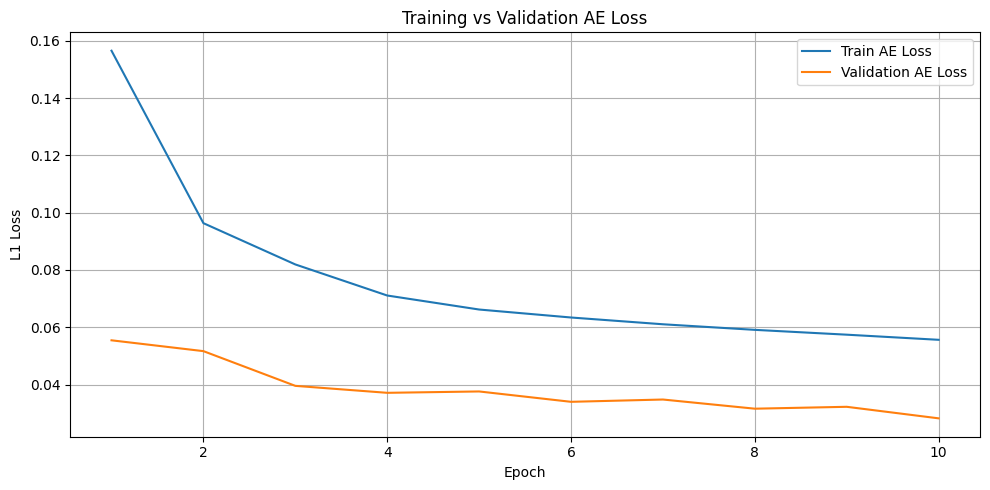

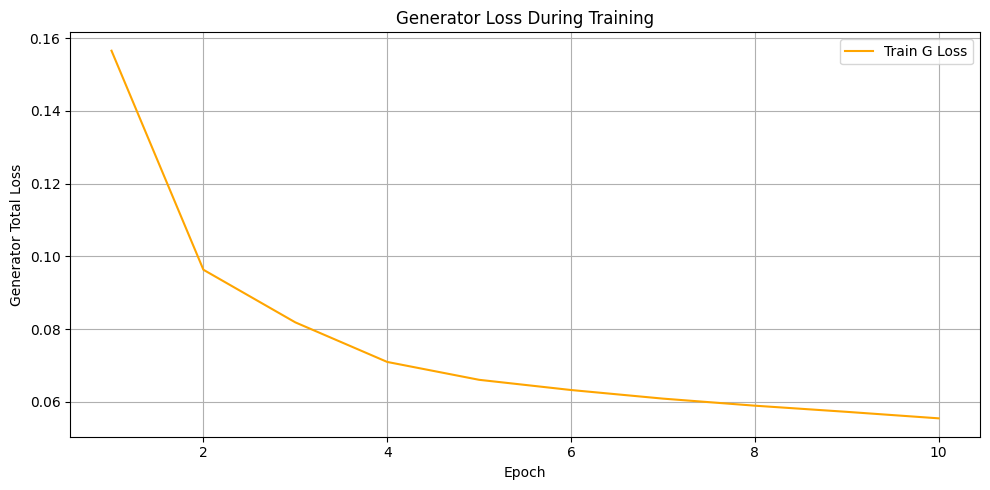

In [14]:
plot_training_metrics(os.path.join(config["checkpoint_dir"], config["metrics_log"]))

## Inline Visualization of Test Outputs

In [13]:
def show_test_examples(generator, loader, num_examples=5):
    generator.eval()
    shown = 0

    for imgs, masks in loader:
        imgs, masks = imgs.to(device), masks.to(device)
        masks = masks.float()

        incomplete = imgs * (1 - masks)
        ones_x = torch.ones_like(incomplete[:, 0:1])
        x = torch.cat([incomplete, ones_x, ones_x * masks], dim=1)

        _, x2 = generator(x, masks)
        output = x2 * masks + incomplete * (1 - masks)

        for i in range(imgs.size(0)):
            if shown >= num_examples:
                return

            fig, axes = plt.subplots(1, 3, figsize=(12, 4))
            axes[0].imshow(imgs[i].permute(1, 2, 0).cpu().numpy())
            axes[0].set_title("Original")
            axes[1].imshow(incomplete[i].permute(1, 2, 0).cpu().numpy())
            axes[1].set_title("Masked Input")
            axes[2].imshow(output[i].permute(1, 2, 0).detach().cpu().numpy())
            axes[2].set_title("Inpainted Output")

            for ax in axes:
                ax.axis("off")
            plt.tight_layout()
            plt.show()

            shown += 1

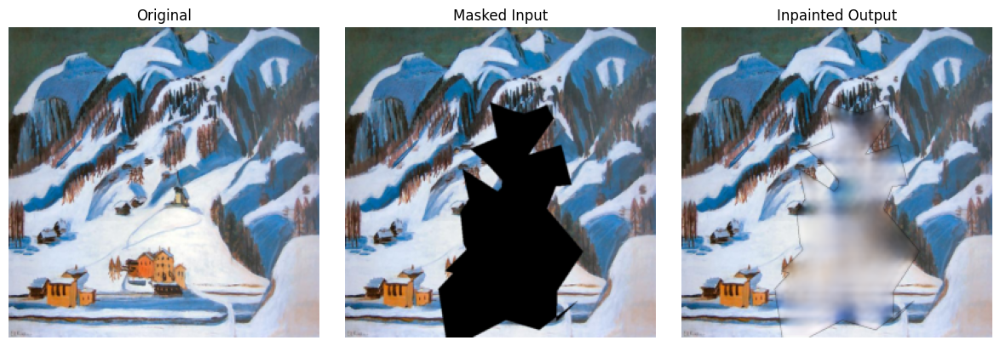

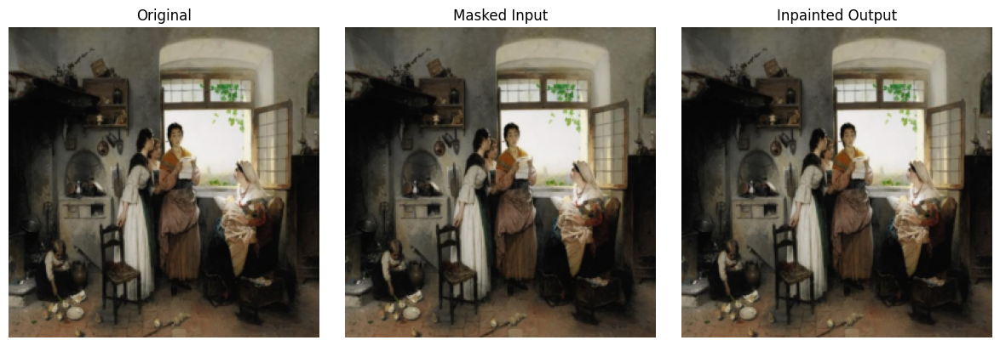

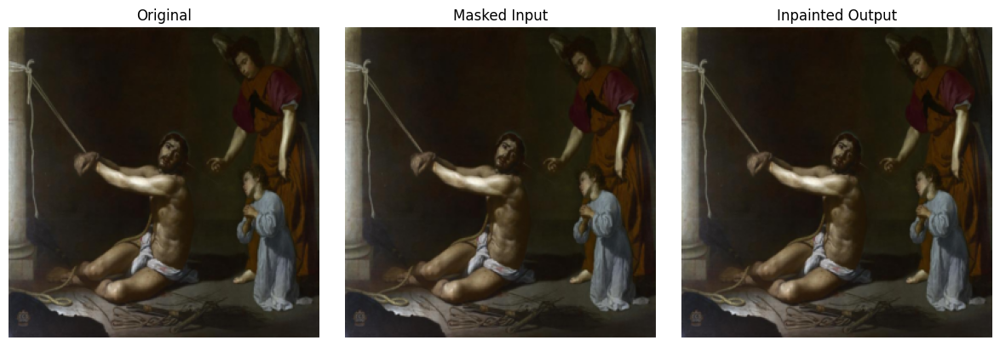

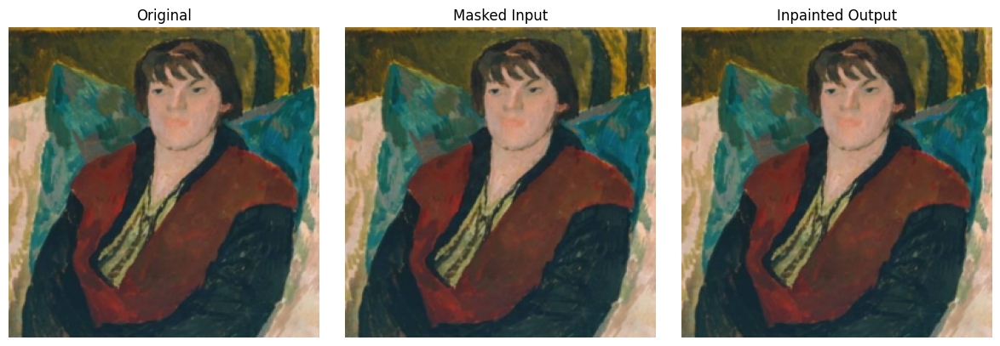

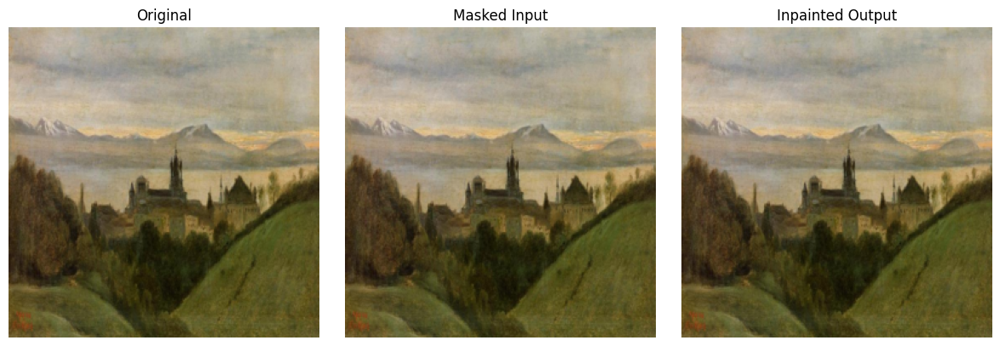

...

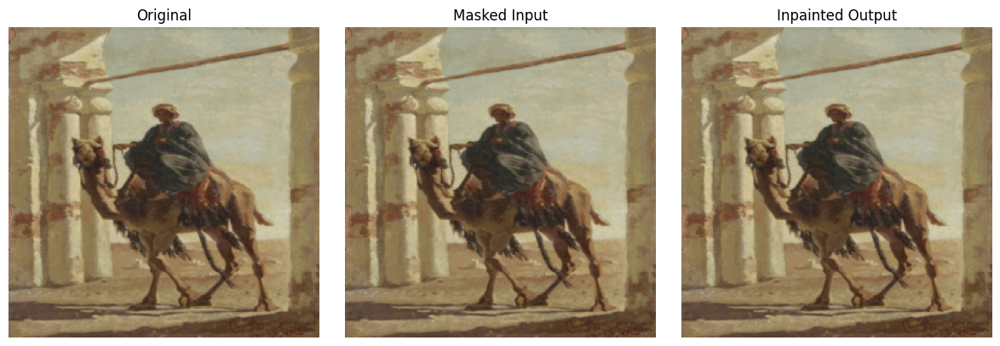

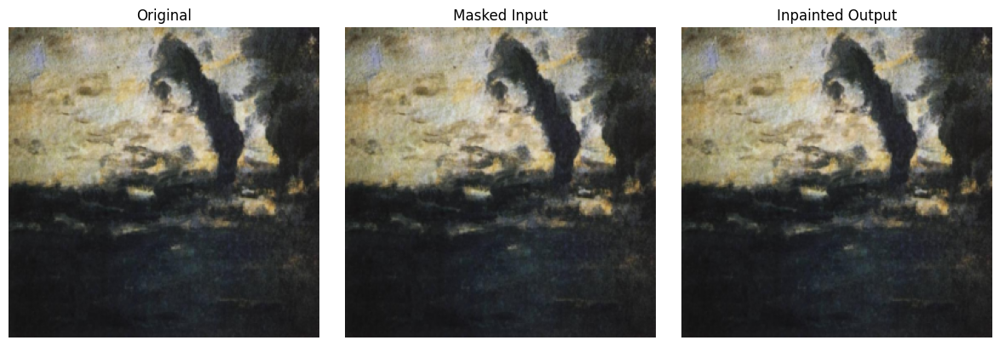

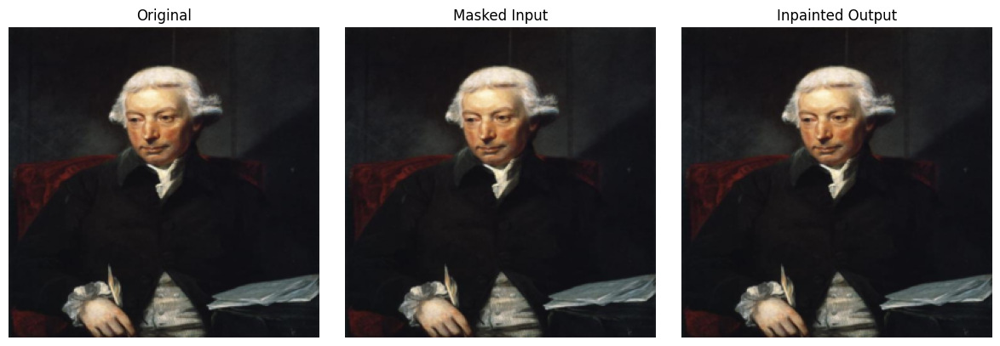

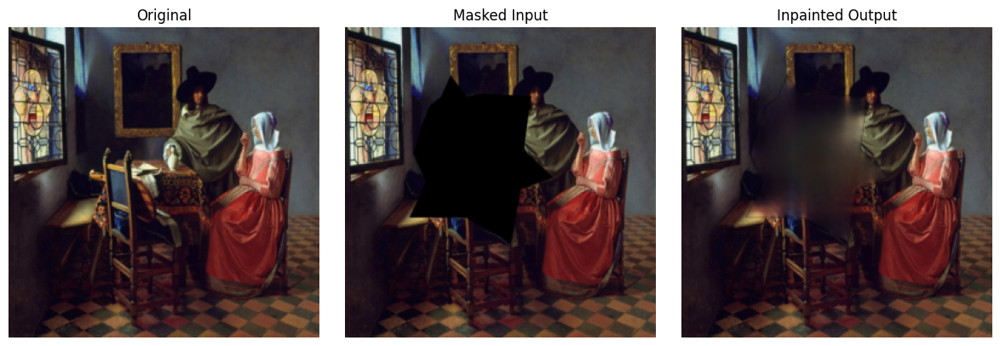

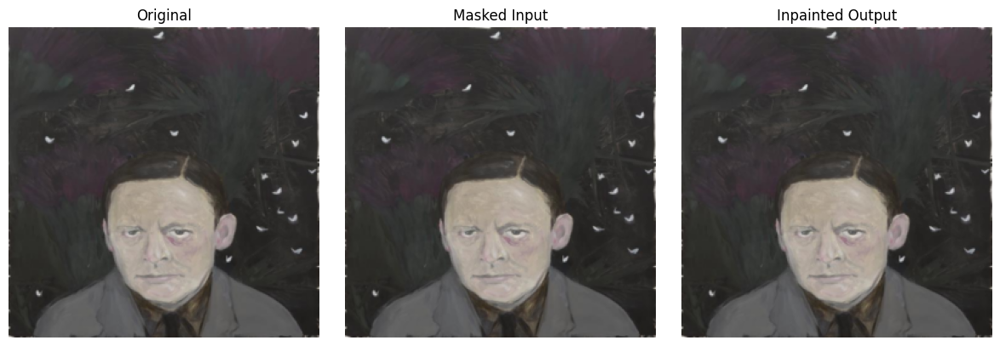

In [16]:
show_test_examples(generator, test_loader, num_examples=30)

## Continuing Training

In [20]:
import os
import torch

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

# Define config
config = {
    "data_root": "data/inpainting-dataset",
    "img_size": (256, 256),
    "batch_size": 4,
    "max_epochs": 20,  # Change this if you want to train more
    "patience": 5,
    "g_lr": 1e-4,
    "d_lr": 1e-4,
    "l1_loss_alpha": 1.0,
    "gan_loss_alpha": 0.001,
    "num_workers": 0,
    "pin_memory": False,
    "checkpoint_dir": "checkpoints/",
    "metrics_log": "metrics_continued.csv",
}
os.makedirs(config["checkpoint_dir"], exist_ok=True)

# Paths to best models
generator_ckpt = "checkpoints/dfv2_generator_epoch_10.pth"
discriminator_ckpt = "checkpoints/dfv2_discriminator_epoch_10.pth"

# Infer last epoch from filename
start_epoch = int(generator_ckpt.split('_epoch_')[1].split('.pth')[0])

# Load models
generator.load_state_dict(torch.load(generator_ckpt))
discriminator.load_state_dict(torch.load(discriminator_ckpt))

# Continue training from the next epoch
train_loop(
    generator=generator,
    discriminator=discriminator,
    g_optimizer=g_optimizer,
    d_optimizer=d_optimizer,
    train_loader=train_loader,
    val_loader=val_loader,
    config=config
)


C:\Users\CNash\AppData\Local\Temp\ipykernel_29760\3482739363.py:33: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  generator.load_state_dict(torch.load(generator_ckpt))
C:\Us

Using device: cuda

[Epoch 1] Starting...


Epoch 1/20: 100%|███████████████| 6052/6052 [15:35<00:00,  6.47it/s, ae_loss=0.0450, g_loss=0.0451, d_loss=0.7534]


[Epoch 1] Train AE: 0.0544 | Val AE: 0.0286
  ↳ New best model found, saving checkpoint...
[Epoch 1] Completed in 1012.74 seconds

[Epoch 2] Starting...


Epoch 2/20: 100%|███████████████| 6052/6052 [15:20<00:00,  6.58it/s, ae_loss=0.0420, g_loss=0.0415, d_loss=0.9609]


[Epoch 2] Train AE: 0.0536 | Val AE: 0.0280
  ↳ New best model found, saving checkpoint...
[Epoch 2] Completed in 997.04 seconds

[Epoch 3] Starting...


Epoch 3/20: 100%|███████████████| 6052/6052 [15:14<00:00,  6.61it/s, ae_loss=0.0537, g_loss=0.0533, d_loss=0.7778]


[Epoch 3] Train AE: 0.0527 | Val AE: 0.0292
  ↳ No improvement. Patience: 1/5
[Epoch 3] Completed in 999.34 seconds

[Epoch 4] Starting...


Epoch 4/20: 100%|███████████████| 6052/6052 [15:32<00:00,  6.49it/s, ae_loss=0.0338, g_loss=0.0335, d_loss=0.6382]


[Epoch 4] Train AE: 0.0515 | Val AE: 0.0278
  ↳ New best model found, saving checkpoint...
[Epoch 4] Completed in 1015.20 seconds

[Epoch 5] Starting...


Epoch 5/20: 100%|███████████████| 6052/6052 [15:36<00:00,  6.46it/s, ae_loss=0.0401, g_loss=0.0396, d_loss=0.7715]


[Epoch 5] Train AE: 0.0501 | Val AE: 0.0262
  ↳ New best model found, saving checkpoint...
[Epoch 5] Completed in 1018.36 seconds

[Epoch 6] Starting...


Epoch 6/20: 100%|███████████████| 6052/6052 [15:38<00:00,  6.45it/s, ae_loss=0.0287, g_loss=0.0287, d_loss=0.8662]


[Epoch 6] Train AE: 0.0490 | Val AE: 0.0251
  ↳ New best model found, saving checkpoint...
[Epoch 6] Completed in 1013.98 seconds

[Epoch 7] Starting...


Epoch 7/20: 100%|███████████████| 6052/6052 [15:13<00:00,  6.63it/s, ae_loss=0.0685, g_loss=0.0687, d_loss=0.7363]


[Epoch 7] Train AE: 0.0483 | Val AE: 0.0258
  ↳ No improvement. Patience: 1/5
[Epoch 7] Completed in 994.20 seconds

[Epoch 8] Starting...


Epoch 8/20: 100%|███████████████| 6052/6052 [15:10<00:00,  6.65it/s, ae_loss=0.0681, g_loss=0.0681, d_loss=0.8164]


[Epoch 8] Train AE: 0.0477 | Val AE: 0.0254
  ↳ No improvement. Patience: 2/5
[Epoch 8] Completed in 985.29 seconds

[Epoch 9] Starting...


Epoch 9/20: 100%|███████████████| 6052/6052 [15:46<00:00,  6.39it/s, ae_loss=0.0341, g_loss=0.0339, d_loss=0.5957]


[Epoch 9] Train AE: 0.0472 | Val AE: 0.0254
  ↳ No improvement. Patience: 3/5
[Epoch 9] Completed in 1026.22 seconds

[Epoch 10] Starting...


Epoch 10/20: 100%|██████████████| 6052/6052 [15:41<00:00,  6.43it/s, ae_loss=0.0465, g_loss=0.0468, d_loss=0.7222]


[Epoch 10] Train AE: 0.0465 | Val AE: 0.0243
  ↳ New best model found, saving checkpoint...
[Epoch 10] Completed in 1019.45 seconds

[Epoch 11] Starting...


Epoch 11/20: 100%|██████████████| 6052/6052 [16:28<00:00,  6.12it/s, ae_loss=0.0721, g_loss=0.0725, d_loss=0.7397]


[Epoch 11] Train AE: 0.0460 | Val AE: 0.0235
  ↳ New best model found, saving checkpoint...
[Epoch 11] Completed in 1074.32 seconds

[Epoch 12] Starting...


Epoch 12/20: 100%|██████████████| 6052/6052 [16:10<00:00,  6.24it/s, ae_loss=0.0475, g_loss=0.0465, d_loss=1.0117]


[Epoch 12] Train AE: 0.0456 | Val AE: 0.0250
  ↳ No improvement. Patience: 1/5
[Epoch 12] Completed in 1053.19 seconds

[Epoch 13] Starting...


Epoch 13/20: 100%|██████████████| 6052/6052 [16:13<00:00,  6.22it/s, ae_loss=0.0539, g_loss=0.0538, d_loss=0.6099]


[Epoch 13] Train AE: 0.0452 | Val AE: 0.0265
  ↳ No improvement. Patience: 2/5
[Epoch 13] Completed in 1059.22 seconds

[Epoch 14] Starting...


Epoch 14/20: 100%|██████████████| 6052/6052 [16:07<00:00,  6.26it/s, ae_loss=0.0307, g_loss=0.0297, d_loss=1.0098]


[Epoch 14] Train AE: 0.0448 | Val AE: 0.0239
  ↳ No improvement. Patience: 3/5
[Epoch 14] Completed in 1051.41 seconds

[Epoch 15] Starting...


Epoch 15/20: 100%|██████████████| 6052/6052 [16:54<00:00,  5.96it/s, ae_loss=0.0521, g_loss=0.0513, d_loss=0.9751]


[Epoch 15] Train AE: 0.0442 | Val AE: 0.0240
  ↳ No improvement. Patience: 4/5
[Epoch 15] Completed in 1103.35 seconds

[Epoch 16] Starting...


Epoch 16/20: 100%|██████████████| 6052/6052 [16:52<00:00,  5.98it/s, ae_loss=0.0275, g_loss=0.0268, d_loss=0.8457]


[Epoch 16] Train AE: 0.0439 | Val AE: 0.0229
  ↳ New best model found, saving checkpoint...
[Epoch 16] Completed in 1095.16 seconds

[Epoch 17] Starting...


Epoch 17/20: 100%|██████████████| 6052/6052 [16:00<00:00,  6.30it/s, ae_loss=0.0396, g_loss=0.0389, d_loss=0.9873]


[Epoch 17] Train AE: 0.0435 | Val AE: 0.0222
  ↳ New best model found, saving checkpoint...
[Epoch 17] Completed in 1037.85 seconds

[Epoch 18] Starting...


Epoch 18/20: 100%|██████████████| 6052/6052 [16:01<00:00,  6.29it/s, ae_loss=0.0582, g_loss=0.0586, d_loss=0.8232]


[Epoch 18] Train AE: 0.0432 | Val AE: 0.0230
  ↳ No improvement. Patience: 1/5
[Epoch 18] Completed in 1043.10 seconds

[Epoch 19] Starting...


Epoch 19/20: 100%|██████████████| 6052/6052 [17:26<00:00,  5.78it/s, ae_loss=0.0293, g_loss=0.0287, d_loss=0.7896]


[Epoch 19] Train AE: 0.0426 | Val AE: 0.0247
  ↳ No improvement. Patience: 2/5
[Epoch 19] Completed in 1274.72 seconds

[Epoch 20] Starting...


Epoch 20/20: 100%|██████████████| 6052/6052 [23:06<00:00,  4.37it/s, ae_loss=0.0652, g_loss=0.0655, d_loss=0.5669]


[Epoch 20] Train AE: 0.0421 | Val AE: 0.0225
  ↳ No improvement. Patience: 3/5
[Epoch 20] Completed in 1463.34 seconds


In [21]:
# Evaluate on test set
test_loss = test_evaluate(generator, test_loader, l1_loss,
                          save_outputs=True,
                          save_dir=os.path.join(config["checkpoint_dir"], "test_outputs"))
print(f"Test AE Loss: {test_loss:.4f}")

Test AE Loss: 0.0200


C:\Users\CNash\AppData\Local\Temp\ipykernel_20316\2590808237.py:4: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state_dict = torch.load("checkpoints/dfv2_generator_epoch_20

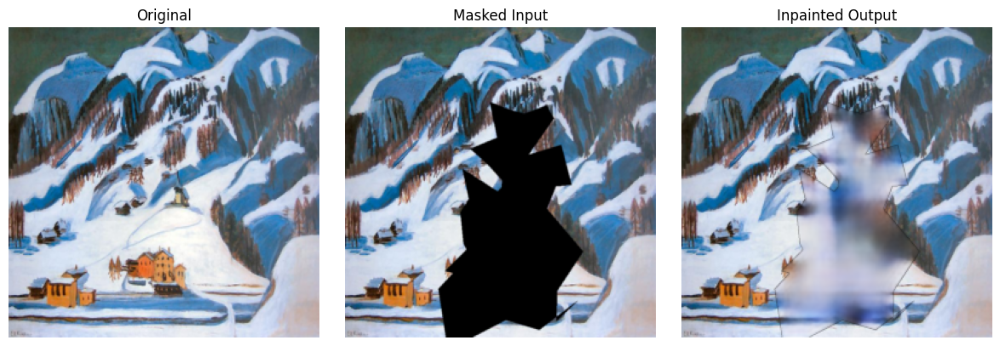

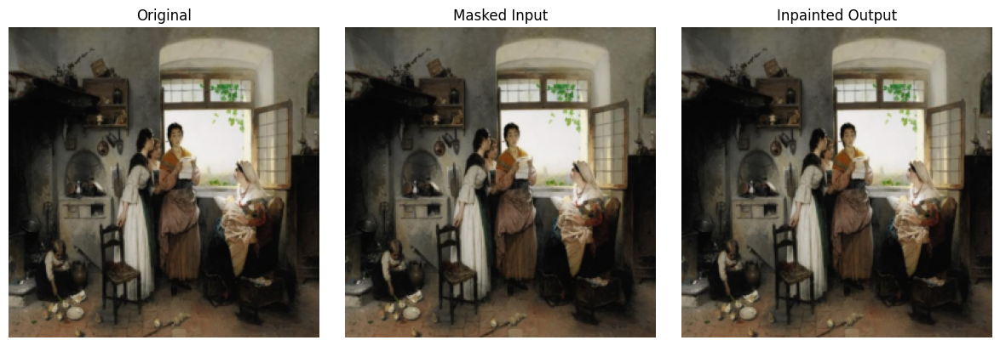

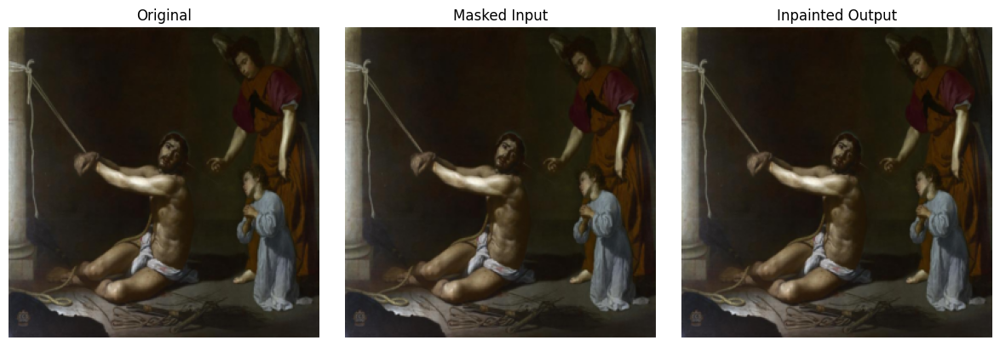

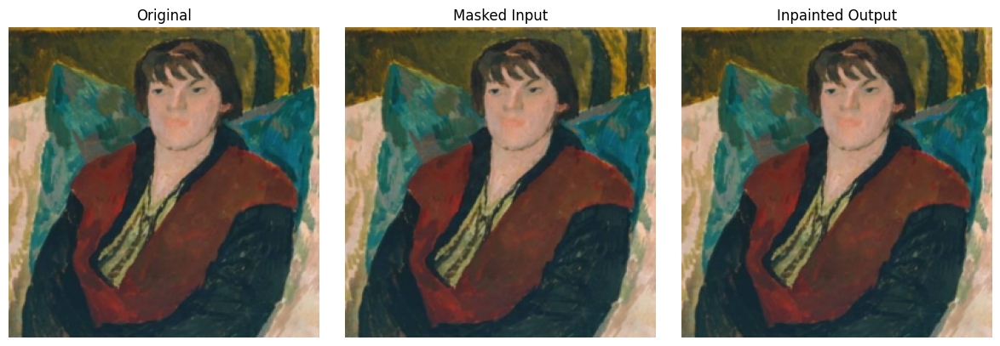

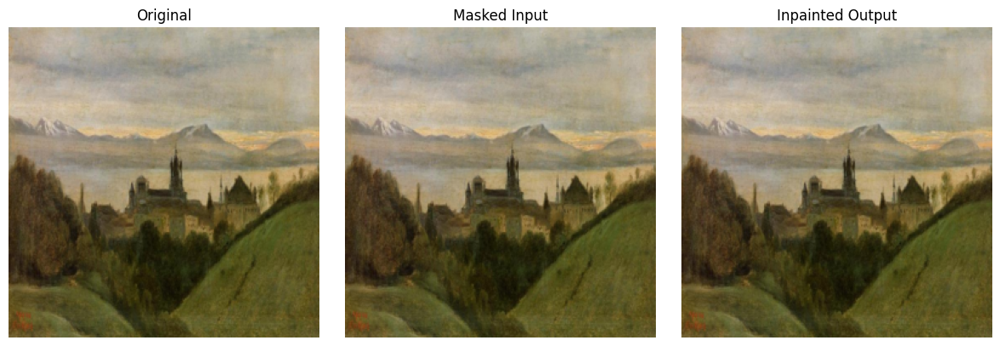

...

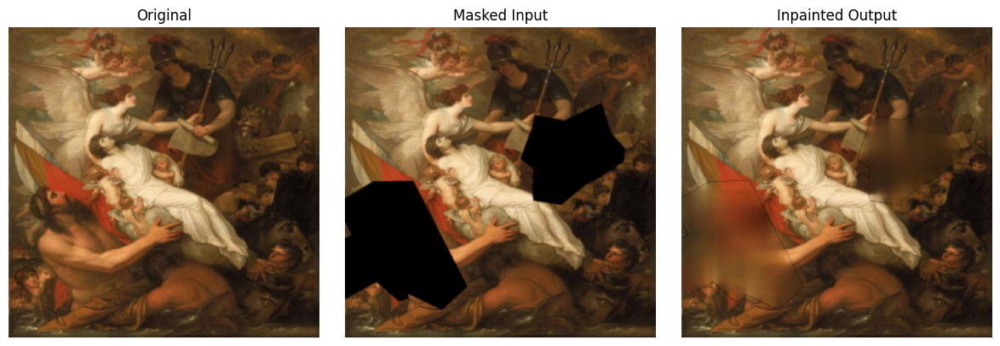

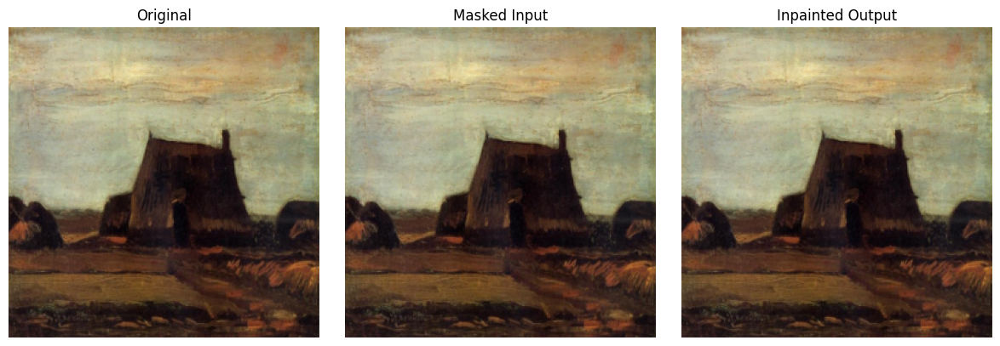

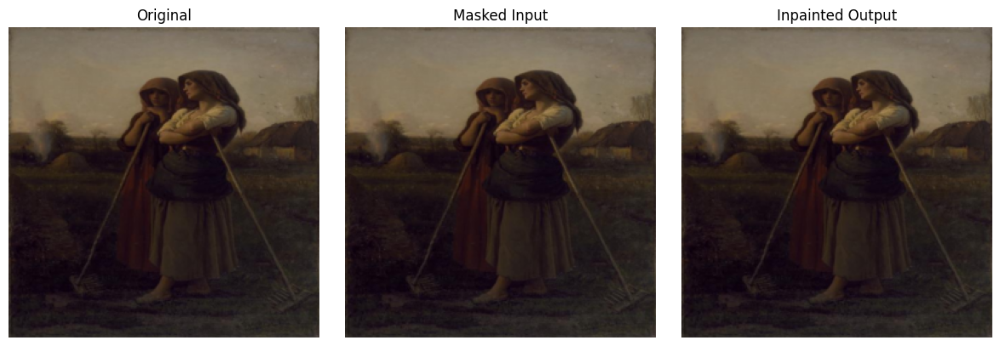

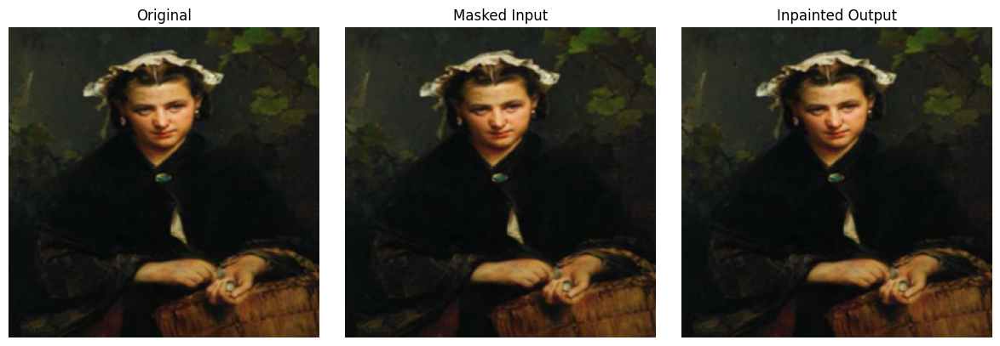

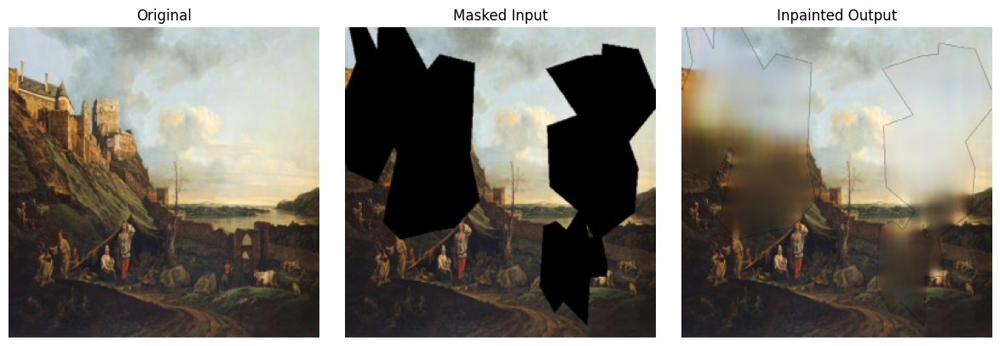

In [15]:
import matplotlib.pyplot as plt

generator = Generator().to(device)
state_dict = torch.load("checkpoints/dfv2_generator_epoch_20.pth")
generator.load_state_dict(state_dict)

show_test_examples(generator, test_loader, num_examples=50)